In [53]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [12]:
# import dataset
df = pd.read_csv('../train_data.csv', index_col='GEOID').drop(columns = 'Unnamed: 0')
df.index = df.index.astype(int).astype(str)

In [9]:
df.describe()

,attr_cnt_1mile,attr_cnt_5mile,distance_to_nearest_attr,crime_population,violent_crime,murder_nonnegligent_manslaughter,Rape1,Robbery,aggravated_assault,property_crime,...,traff_cnt_10m_max,traff_cnt_5m_avg,traff_cnt_5m_max,ev_cnt,attr_cnt,traffic_cnt,traffic_max,traffic_avg,geometry,category
count,1045.000000,1045.000000,1045.000000,1.045000e+03,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000,...,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000,1045.000000
mean,0.204453,3.473158,2.354489,6.620731e+05,2491.060942,18.847835,291.033591,746.781210,1434.398306,24025.921046,...,131182.740032,27543.391266,109943.575317,1.064115,0.492823,5.124402,48488.701770,24651.047484,0.013984,1.605742
std,0.870140,7.402123,0.945103,7.409894e+05,2681.000358,21.224306,280.528058,905.006475,1485.144650,27176.606496,...,81498.362227,15437.424303,77240.778331,2.852488,1.526018,6.820905,39876.001398,18235.497830,0.049656,0.709518
min,0.000000,0.000000,0.087300,1.421000e+03,1.000000,0.000000,0.000000,0.000000,1.000000,16.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,620.000000,430.000000,0.000022,0.000000
25%,0.000000,0.000000,1.987400,9.259300e+04,263.000000,2.000000,43.000000,53.000000,167.000000,2343.000000,...,56000.000000,14879.365079,35000.000000,0.000000,0.000000,0.000000,18000.000000,11260.000000,0.000283,1.000000
50%,0.000000,1.000000,2.300410,3.546350e+05,953.000000,7.061728,230.000000,219.000000,571.000000,11159.000000,...,133000.000000,28425.288462,107000.000000,0.000000,0.000000,3.000000,49000.000000,27000.000000,0.000552,2.000000
75%,0.000000,3.000000,2.523800,1.868675e+06,6725.000000,53.000000,729.000000,2217.000000,3726.000000,68000.000000,...,219000.000000,39979.487179,186000.000000,1.000000,0.000000,8.000000,57319.303338,30561.590107,0.002813,2.000000
max,13.000000,47.500000,4.967050,1.868675e+06,6725.000000,53.000000,729.000000,2217.000000,3726.000000,68000.000000,...,240000.000000,71182.625000,240000.000000,45.000000,30.000000,60.000000,240000.000000,148000.000000,0.483297,2.000000


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1045 entries, 53001950100 to 53077940005
Data columns (total 36 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   attr_cnt_1mile                    1045 non-null   float64
 1   attr_cnt_5mile                    1045 non-null   float64
 2   distance_to_nearest_attr          1045 non-null   float64
 3   crime_population                  1045 non-null   float64
 4   violent_crime                     1045 non-null   float64
 5   murder_nonnegligent_manslaughter  1045 non-null   float64
 6   Rape1                             1045 non-null   float64
 7   Robbery                           1045 non-null   float64
 8   aggravated_assault                1045 non-null   float64
 9   property_crime                    1045 non-null   float64
 10  Burglary                          1045 non-null   float64
 11  larceny_theft                     1045 non-null   float64

In [13]:
df.columns.values

array(['attr_cnt_1mile', 'attr_cnt_5mile', 'distance_to_nearest_attr',
       'crime_population', 'violent_crime',
       'murder_nonnegligent_manslaughter', 'Rape1', 'Robbery',
       'aggravated_assault', 'property_crime', 'Burglary',
       'larceny_theft', 'motor_vehicle_theft', 'Arson', 'total_crime',
       'num_EV_in_2_miles_of_gas', 'num_EV_in_5_miles_of_gas',
       'num_EV_in_10_miles_of_gas', 'num_EV_in_20_miles_of_gas',
       'num_EV_in_50_miles_of_gas', 'distance_to_closest_ev_station',
       'nri_population', 'nri_risk_score', 'census_tract_area',
       'census_tract_category', 'traff_cnt_10m_avg', 'traff_cnt_10m_max',
       'traff_cnt_5m_avg', 'traff_cnt_5m_max', 'ev_cnt', 'attr_cnt',
       'traffic_cnt', 'traffic_max', 'traffic_avg', 'geometry',
       'category'], dtype=object)

In [20]:
df_baseline = df.loc[df.category == 2]
df_finetune = df.loc[df.category == 1]
df_target = df.loc[df.category == 0]
print('baseline dataset: {0}, finetune dataset: {1}, target dataset: {2}'.format(df_baseline.shape, df_finetune.shape, df_target.shape))

baseline dataset: (771, 36), finetune dataset: (136, 36), target dataset: (138, 36)


## baseline model training

<AxesSubplot:>

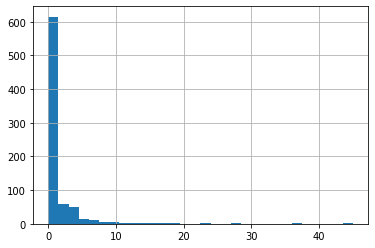

In [104]:
X = df_baseline.drop(columns = 'ev_cnt')
y = df_baseline.ev_cnt
y.hist(bins=30)

In [89]:
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.33, random_state=42)
print('training dataset: {0}, testing dataset: {1}'.format(X_train.shape, X_val.shape))

training dataset: (516, 35), testing dataset: (255, 35)


In [37]:
# from sklearn.model_selection import train_test_split
# X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.33, random_state=42)
# X_test, X_val, y_test, y_val = train_test_split(X_val, y_val, test_size=0.5, random_state=42)
# print('training dataset: {0}, validation dataset: {1}, testing dataset: {2}'.format(X_train.shape, X_val.shape, X_test.shape))

training dataset: (516, 35), validation dataset: (128, 35), testing dataset: (127, 35)


### Random Forest

In [63]:
from sklearn.ensemble import RandomForestRegressor
reg = RandomForestRegressor(n_estimators=100, random_state=42)
reg.fit(X_train, y_train)
y_pred = reg.predict(X_val)
print(reg.score(X_val, y_val))
# print(reg.score(X_test, y_test))

0.3216083963845492


### try xgboost

In [105]:
import xgboost as xgb
xgb_reg = xgb.XGBRegressor()
xgb_reg.fit(X_train, y_train)
y_pred = xgb_reg.predict(X_val)
print(xgb_reg.score(X_val, y_val))
# print(xgb_reg.score(X_test, y_test))

0.3238094530065254


### Linear Regression

In [65]:
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)
y_pred = lin_reg.predict(X_val)
print(lin_reg.score(X_val, y_val))
# print(lin_reg.score(X_test, y_test))

0.24567021837960568


### Gamma regressor

-0.011423954353097399


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

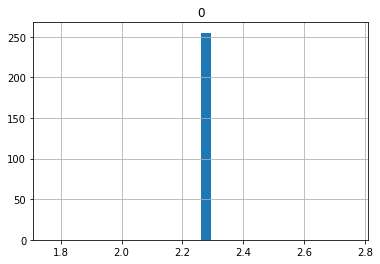

In [100]:
from sklearn.linear_model import GammaRegressor
ga_reg = GammaRegressor()
y_train_shift = y_train+1
ga_reg.fit(X_train, y_train_shift)
y_pred = ga_reg.predict(X_val)
y_val_shift = y_val+1
print(ga_reg.score(X_val, y_val_shift))
# print(ga_reg.score(X_test, y_test))
pd.DataFrame(y_pred).hist(bins=30)

### ElasticNet

0.0540415004422109


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

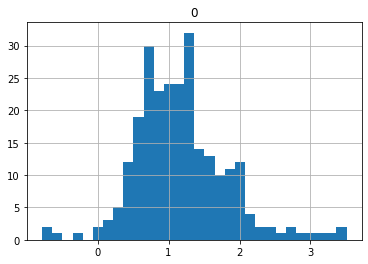

In [101]:
from sklearn.linear_model import ElasticNetCV
en_reg = ElasticNetCV(cv=5, random_state=0)
en_reg.fit(X_train, y_train)
y_pred = en_reg.predict(X_val)
print(en_reg.score(X_val, y_val))
# print(en_reg.score(X_test, y_test))
pd.DataFrame(y_pred).hist(bins=30)

### Prediction Visualization

In [106]:
# plot EV count Choropleth
# city: 0.0025, suburban: 0.007, rural: other
import folium

center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               
tmp = X_val.join(y_val)
tmp['prediction'] = y_pred

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'prediction'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    legend_name="prediction",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m

array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

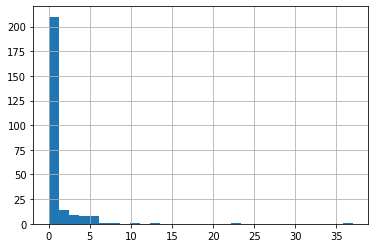

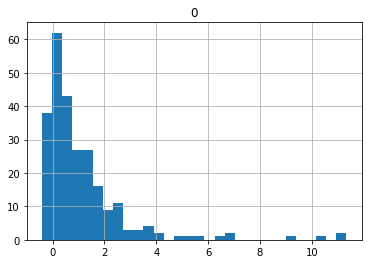

In [107]:
y_val.hist(bins=30)
pd.DataFrame(y_pred).hist(bins=30)

In [108]:
# true values visualization

center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               
tmp = X_val.join(y_val)
tmp['prediction'] = y_pred

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'ev_cnt'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    legend_name="true label",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m

### try full dataset

In [178]:
X_train = df.loc[(df.category == 2) | (df.category == 1)].drop(columns = 'ev_cnt')
y_train = df.loc[(df.category == 2) | (df.category == 1)].ev_cnt
X_test = df.loc[df.category == 0].drop(columns = 'ev_cnt')
y_test = df.loc[df.category == 0].ev_cnt
print(X_train.shape, X_test.shape)

(907, 35) (138, 35)


<AxesSubplot:>

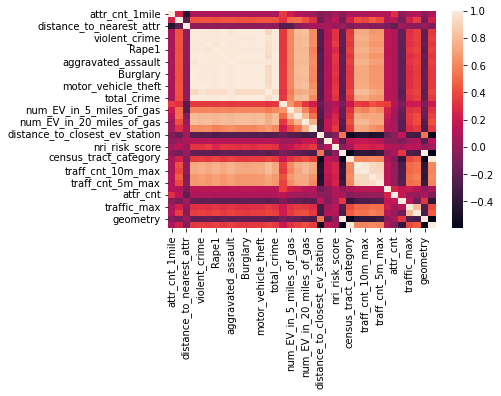

In [179]:
sns.heatmap(df.corr())

<AxesSubplot:>

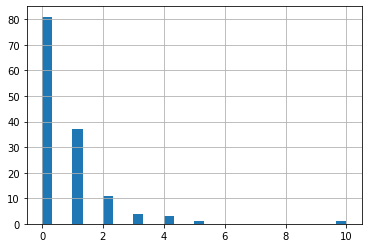

In [125]:
y_test.hist(bins=30)

0.35849746552512685
mean_squared_error 1.108695652173913
r2_score 0.3058258811152026


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

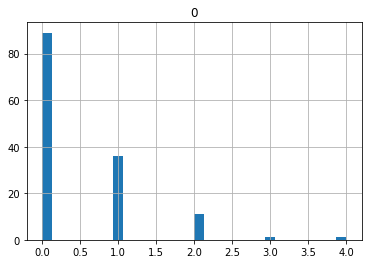

In [204]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score
xgb_reg = xgb.XGBRegressor()
xgb_reg.fit(X_train, y_train)
y_pred = xgb_reg.predict(X_test)
print(xgb_reg.score(X_test, y_test))
print("mean_squared_error", mean_squared_error(y_test,y_pred.astype(int)))
print("r2_score", r2_score(y_test,y_pred.astype(int)))
pd.DataFrame(y_pred.astype(int)).hist(bins=30)

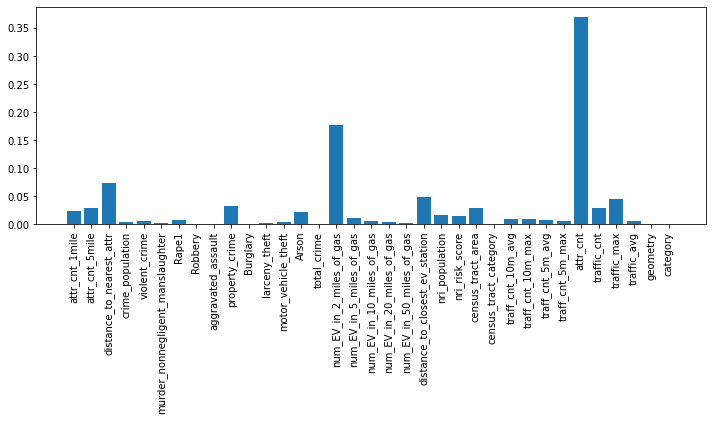

In [181]:
plt.figure(figsize=(12,4))
plt.bar(X_train.columns, xgb_reg.feature_importances_)
plt.xticks(rotation = 90)
plt.show()

In [195]:
gas_points = pd.read_csv('../data/wa_gas_stations.csv')
gas_points.columns

Index(['Longitude', 'Latitude', 'name'], dtype='object')

In [201]:
# TODO: what are the null values

# predicted values visualization
center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               
tmp = X_test.join(y_test)
tmp['prediction'] = y_pred.astype(int)

# draw gas stations
# gas_points = pd.read_csv('../data/wa_gas_stations.csv')
# for lng, lat, name in gas_points.values:
#     label = '{}'.format(name)
#     label = folium.Popup(label, parse_html=True)
#     folium.Circle([lat, lng],
#     radius=5,
#     popup=label,
#     color='blue',
#     fill=True,
#     fill_color='#3186cc',
#     fill_opacity=0.7).add_to(m) 


cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'prediction'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    threshold_scale=np.linspace(0,11,10),
    legend_name="predicted label",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m

In [193]:
df[df.index == '53059950100']

,attr_cnt_1mile,attr_cnt_5mile,distance_to_nearest_attr,crime_population,violent_crime,murder_nonnegligent_manslaughter,Rape1,Robbery,aggravated_assault,property_crime,...,traff_cnt_10m_max,traff_cnt_5m_avg,traff_cnt_5m_max,ev_cnt,attr_cnt,traffic_cnt,traffic_max,traffic_avg,geometry,category
GEOID,,,,,,,,,,,,,,,,,,,,,


In [200]:
# true values visualization
center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               
tmp = X_test.join(y_test)
tmp['prediction'] = y_pred

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'ev_cnt'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    threshold_scale=np.linspace(0,11,10),
    legend_name="true label",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m